In [1]:
import os
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score,f1_score,precision_score,recall_score,matthews_corrcoef,roc_curve, auc
import glob,ast
import matplotlib.pyplot as plt

In [2]:
pwd

'/rds/user/co-gora1/hpc-work/DGraphDTA'

In [3]:
with open('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/proteins_updated.txt') as f:
    data = f.read()

d = ast.literal_eval(data)
proteins_list=list(d.keys())

In [4]:
proteins_list

['O00141',
 'O00311',
 'O00418',
 'O00444',
 'O14757',
 'O14920',
 'O14965',
 'O15075',
 'O15111',
 'O15264',
 'O15530',
 'O43293',
 'O43741',
 'O43781',
 'O60285',
 'O75582',
 'O75676',
 'O94806',
 'O96013',
 'O96017',
 'P04049',
 'P04629',
 'P05129',
 'P05771',
 'P06239',
 'P06241',
 'P06493',
 'P07332',
 'P07333',
 'P07947',
 'P07948',
 'P08631',
 'P09769',
 'P10721',
 'P11309',
 'P11362',
 'P11802',
 'P12931',
 'P15056',
 'P15735',
 'P16591',
 'P17252',
 'P17612',
 'P19784',
 'P21802',
 'P22455',
 'P22607',
 'P22612',
 'P22694',
 'P23443',
 'P24723',
 'P24941',
 'P27361',
 'P27448',
 'P28482',
 'P29317',
 'P29376',
 'P30291',
 'P30530',
 'P31749',
 'P31751',
 'P34947',
 'P36507',
 'P36888',
 'P41240',
 'P41279',
 'P41743',
 'P42679',
 'P42685',
 'P43403',
 'P43405',
 'P45983',
 'P45984',
 'P48729',
 'P48730',
 'P49137',
 'P49336',
 'P49674',
 'P49759',
 'P49760',
 'P49840',
 'P49841',
 'P50613',
 'P50750',
 'P51451',
 'P51617',
 'P51812',
 'P51813',
 'P51817',
 'P51955',
 'P51957',

In [75]:
def compare_cmaps(results_path,contact_alpha,contact_esm,contact_pcons,protein_name):
    contact_pdb=contact_alpha
    contact_esm_flatten=contact_esm.flatten()
    contact_pdb_flatten=contact_alpha.flatten()
    contact_pcons_flatten=contact_pcons.flatten()
    gt=np.where(contact_pdb == 1)
    pred=np.where(contact_esm == 1)
    fps=np.where(contact_pdb-contact_esm==-1)
    tps=np.where(contact_esm+contact_pdb==2)
    fns=np.where(contact_pdb-contact_esm==1)
    pred1=np.where(contact_pcons == 1)
    fps1=np.where(contact_pdb-contact_pcons==-1)
    tps1=np.where(contact_pcons+contact_pdb==2)
    fns1=np.where(contact_pdb-contact_pcons==1)
    acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
    mcc,prec,recall=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten),precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
    acc1,f11=accuracy_score(contact_pdb_flatten,contact_pcons_flatten),f1_score(contact_pdb_flatten,contact_pcons_flatten)
    mcc1,prec1,recall1=matthews_corrcoef(contact_pdb_flatten,contact_pcons_flatten),precision_score(contact_pdb_flatten,contact_pcons_flatten),recall_score(contact_pdb_flatten,contact_pcons_flatten)
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))

    ax[0].scatter(gt[0],gt[1],c='grey',marker=".")
    ax[0].set_title('AlphaFold',fontsize=14)
    ax[0].invert_yaxis()
    ax[0] = ax[0].set_aspect('equal', 'box')

    scatter1 = ax[1].scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
    scatter2 = ax[1].scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
    scatter3=ax[1].scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
    ax1 = scatter1.axes
    ax1.invert_yaxis()
    ax2 = scatter2.axes
    ax2.invert_yaxis()
    ax3 = scatter3.axes
    ax3.invert_yaxis()
    ax[1].set_aspect('equal', 'box')
    ax[1].set_title('ESM',fontsize=14)
    # scatter1 = scatter1.set_aspect('equal', 'box')
    # scatter2 = scatter2.set_aspect('equal', 'box')
    # scatter3= scatter3.set_aspect('equal', 'box')
    #ax[2] = ax[2].axes
    scatter11 = ax[2].scatter(gt[0],gt[1],c='grey',marker=".")
    scatter21 = ax[2].scatter(fps1[0],fps1[1],c='red', marker="x")
    scatter31=ax[2].scatter(tps1[0],tps1[1],c='blue', marker="o")
    ax11 = scatter11.axes
    ax11.invert_yaxis()
    ax21 = scatter21.axes
    ax21.invert_yaxis()
    ax31 = scatter31.axes
    ax31.invert_yaxis()
    ax[2].set_aspect('equal', 'box')
    ax[2].set_title('Pconcs4',fontsize=14)
    fig.legend(loc="center right")
    #fig.tight_layout()
    final_result_path=results_path+protein_name+".pdf"
    fig.savefig(final_result_path, bbox_inches='tight',dpi=200)
    return mcc,f1,prec,mcc1,f11,prec1

(431, 431) (431, 431) (431, 431)
(574, 574) (574, 574) (574, 574)
(725, 725) (725, 725) (725, 725)
(970, 970) (970, 970) (970, 970)
(476, 476) (476, 476) (476, 476)
(756, 756) (756, 756) (756, 756)
(403, 403) (403, 403) (403, 403)
(740, 740) (740, 740) (740, 740)
(745, 745) (745, 745) (745, 745)
(365, 365) (365, 365) (365, 365)
(556, 556) (556, 556) (556, 556)
(454, 454) (454, 454) (454, 454)
(272, 272) (272, 272) (272, 272)
(588, 588) (588, 588) (588, 588)
(661, 661) (661, 661) (661, 661)
(802, 802) (802, 802) (802, 802)
(772, 772) (772, 772) (772, 772)
(890, 890) (890, 890) (890, 890)
(591, 591) (591, 591) (591, 591)
(543, 543) (543, 543) (543, 543)
(648, 648) (648, 648) (648, 648)


/tmp/ipykernel_203196/2346045847.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))


(796, 796) (796, 796) (796, 796)
(697, 697) (697, 697) (697, 697)
(671, 671) (671, 671) (671, 671)
(509, 509) (509, 509) (509, 509)
(537, 537) (537, 537) (537, 537)
(297, 297) (297, 297) (297, 297)
(822, 822) (822, 822) (822, 822)
(972, 972) (972, 972) (972, 972)
(543, 543) (543, 543) (543, 543)
(512, 512) (512, 512) (512, 512)
(526, 526) (526, 526) (526, 526)
(529, 529) (529, 529) (529, 529)
(976, 976) (976, 976) (976, 976)
(313, 313) (404, 404) (404, 404)
(822, 822) (822, 822) (822, 822)
(303, 303) (303, 303) (303, 303)
(536, 536) (536, 536) (536, 536)
(766, 766) (766, 766) (766, 766)
(406, 406) (406, 406) (406, 406)
(822, 822) (822, 822) (822, 822)
(672, 672) (672, 672) (672, 672)
(351, 351) (351, 351) (351, 351)
(350, 350) (350, 350) (350, 350)
(821, 821) (821, 821) (821, 821)
(802, 802) (802, 802) (802, 802)
(806, 806) (806, 806) (806, 806)
(351, 351) (351, 351) (351, 351)
(351, 351) (351, 351) (351, 351)
(525, 525) (525, 525) (525, 525)
(683, 683) (683, 683) (683, 683)
(298, 298)

FileNotFoundError: [Errno 2] No such file or directory: '/disk/scratch/DGraphDTA/data/kiba/alpha_fold_cmaps/P78527.npy'

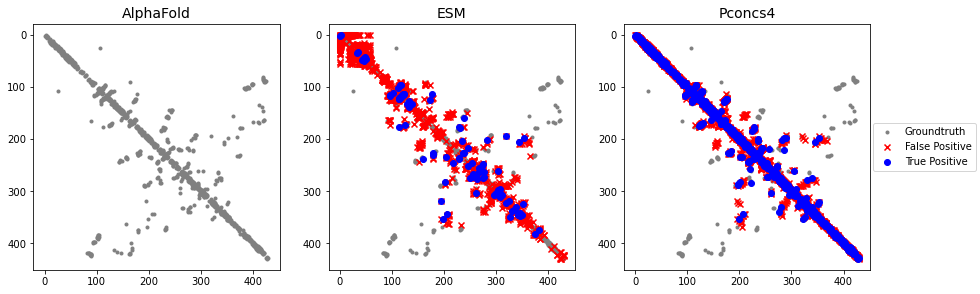

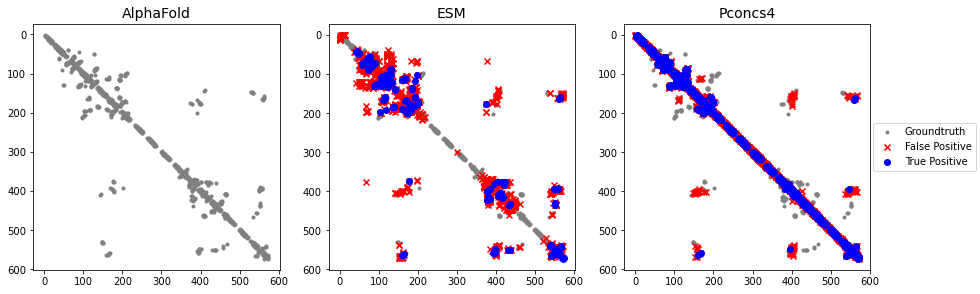

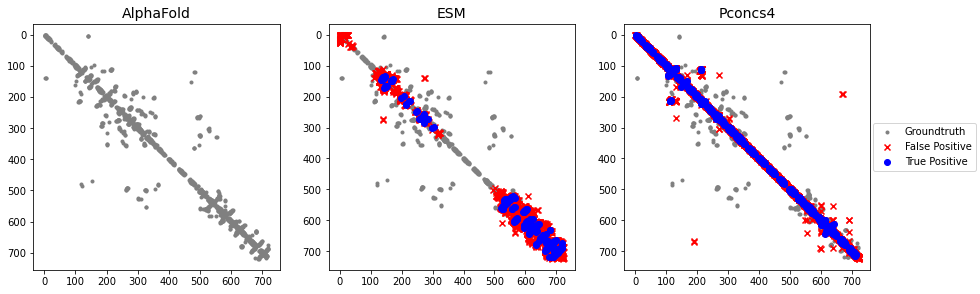

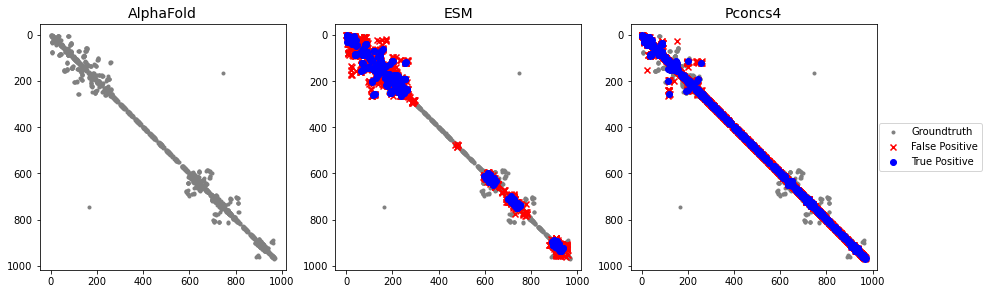

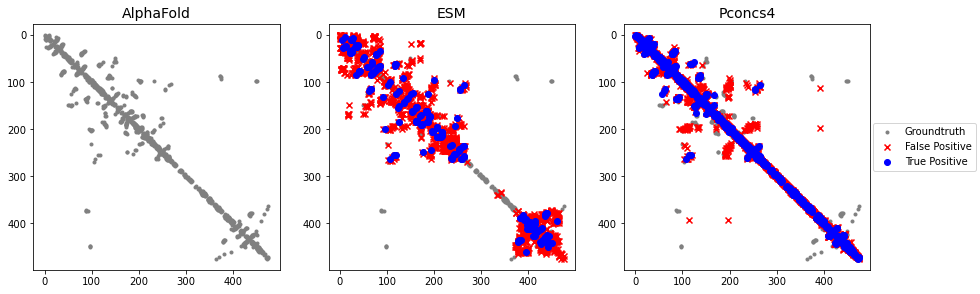

...

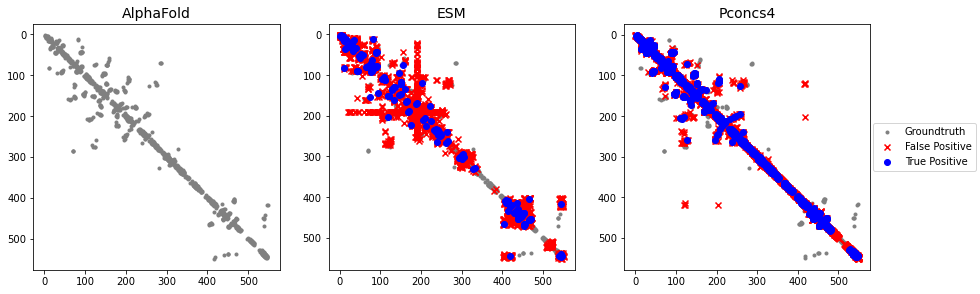

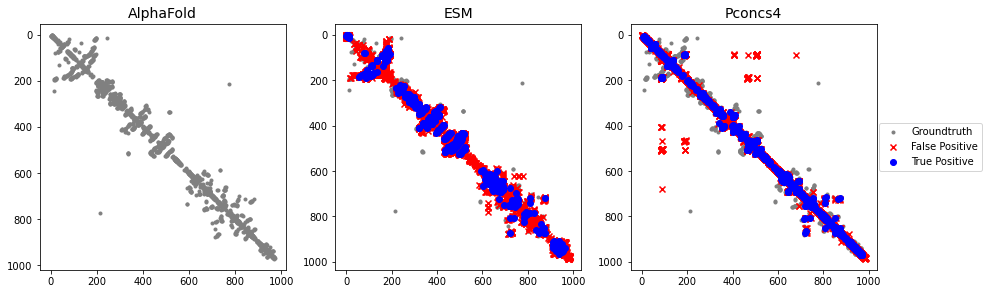

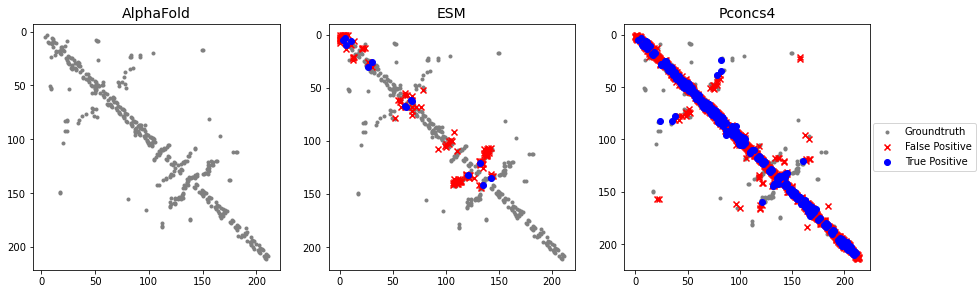

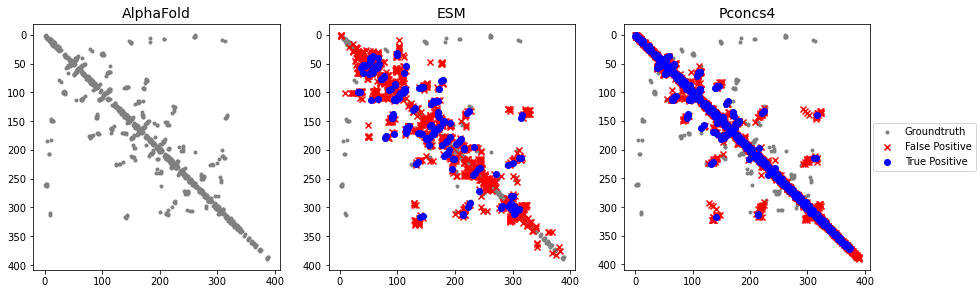

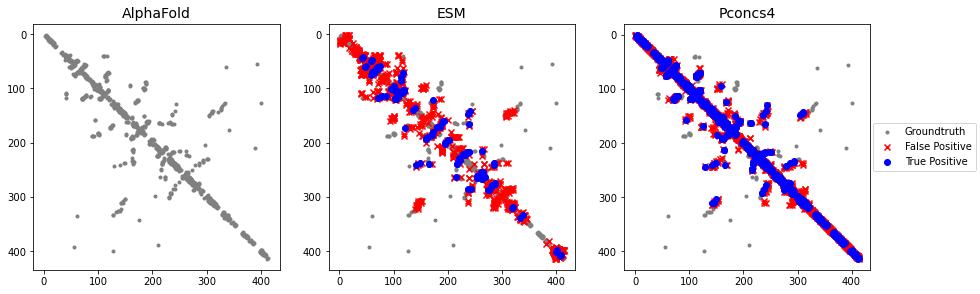

In [79]:
mcc_list=[]
mcc_list1=[]
f1_list=[]
f1_list1=[]
prec_list=[]
prec_list1=[]
for i in proteins_list:
    pro=i+".npy"
    contact_alpha=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/alpha_fold_cmaps/',pro))
    contact_esm=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/esm_cmaps/',pro))
    contact_pcons=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/pconsc4/',pro))
    contact_pcons=np.where(contact_pcons > 0.5, 1, 0)
    print(np.shape(contact_alpha),np.shape(contact_esm),np.shape(contact_pcons))
    results_path='/disk/scratch/DGraphDTA/results1/cmaps/'
    if contact_alpha.shape[0]==contact_esm.shape[0] and contact_alpha.shape[0]==contact_pcons.shape[0]:
        mcc,f1,prec,mcc1,f11,prec1=compare_cmaps(results_path,contact_alpha,contact_esm,contact_pcons,i)
        mcc_list.append(mcc)
        mcc_list1.append(mcc1)
        f1_list.append(f1)
        f1_list1.append(f11)
        prec_list.append(prec)
        prec_list1.append(prec1)
    else:
        continue

In [ ]:
['pconsc4', 'esm_cmaps', 'alpha_fold_cmaps','rand_cmaps']

In [8]:
pro=proteins_list[3]+".npy"
contact_alpha=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/alpha_fold_cmaps/',pro))
contact_esm=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/esm_cmaps/',pro))
contact_ran=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/rand_cmaps/',pro))
contact_pcons=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/pconsc4/',pro))
contact_pcons=np.where(contact_pcons > 0.5, 1, 0)
print(np.shape(contact_alpha),np.shape(contact_esm),np.shape(contact_pcons))


(970, 970) (970, 970) (970, 970)


In [30]:
esm_list=[]
alpha_list=[]
ran_list=[]
pcons_list=[]
seq_list=[]

for i in proteins_list:
    pro=i+".npy"
    #pro=proteins_list[3]+".npy"
    contact_alpha=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/alpha_fold_cmaps/',pro))
    contact_esm=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/esm_cmaps/',pro))
    contact_ran=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/rand_cmaps/',pro))
    contact_pcons=np.load(os.path.join('/rds/user/co-gora1/hpc-work/DGraphDTA/data/kiba/pconsc4/',pro))
    contact_pcons=np.where(contact_pcons > 0.5, 1, 0)
    print(np.shape(contact_alpha),np.shape(contact_esm),np.shape(contact_pcons))
    contact_esm_flatten=contact_esm.flatten()
    contact_alpha_flatten=contact_alpha.flatten()
    contact_pcons_flatten=contact_pcons.flatten()
    contact_ran_flatten=contact_ran.flatten()
    
    res_alpha = (len(list(filter(lambda ele: ele > 0,contact_alpha_flatten))) / len(contact_alpha_flatten)) * 100
    res_esm = (len(list(filter(lambda ele: ele > 0,contact_esm_flatten))) / len(contact_esm_flatten)) * 100
    res_pcons = (len(list(filter(lambda ele: ele > 0,contact_pcons_flatten))) / len(contact_pcons_flatten)) * 100
    res_ran = (len(list(filter(lambda ele: ele > 0,contact_ran_flatten))) / len(contact_ran_flatten)) * 100
    
    seq_list.append(contact_esm.shape[0])
    
    esm_list.append(res_esm)
    alpha_list.append(res_alpha)
    ran_list.append(res_ran)
    pcons_list.append(res_pcons)
 
    
    
      

    
    
   

(431, 431) (431, 431) (431, 431)
(574, 574) (574, 574) (574, 574)
(725, 725) (725, 725) (725, 725)
(970, 970) (970, 970) (970, 970)
(476, 476) (476, 476) (476, 476)
(756, 756) (756, 756) (756, 756)
(403, 403) (403, 403) (403, 403)
(740, 740) (740, 740) (740, 740)
(745, 745) (745, 745) (745, 745)
(365, 365) (365, 365) (365, 365)
(556, 556) (556, 556) (556, 556)
(454, 454) (454, 454) (454, 454)
(272, 272) (272, 272) (272, 272)
(588, 588) (588, 588) (588, 588)
(661, 661) (661, 661) (661, 661)
(802, 802) (802, 802) (802, 802)
(772, 772) (772, 772) (772, 772)
(890, 890) (890, 890) (890, 890)
(591, 591) (591, 591) (591, 591)
(543, 543) (543, 543) (543, 543)
(648, 648) (648, 648) (648, 648)
(796, 796) (796, 796) (796, 796)
(697, 697) (697, 697) (697, 697)
(671, 671) (671, 671) (671, 671)
(509, 509) (509, 509) (509, 509)
(537, 537) (537, 537) (537, 537)
(297, 297) (297, 297) (297, 297)
(822, 822) (822, 822) (822, 822)
(972, 972) (972, 972) (972, 972)
(543, 543) (543, 543) (543, 543)
(512, 512)

In [52]:
name="contacts"+"_2000_188"
result_file_name = 'results2/' + name + '.txt'

result_str = ''

result_str += 'random:' + str(np.mean(ran_list)) + ' std-'+ str(np.std(ran_list)) + ' \n' + ' esm:' + str(np.mean(esm_list)) +' std-'+ str(np.std(esm_list)) + ' \n'+ ' ' + ' pcons:' + str(
         np.mean(pcons_list))+' std-'+ str(np.std(pcons_list)) + ' \n' + ' '  + 'alphafold:' + str(np.mean(alpha_list))+' std-'+ str(np.std(alpha_list)) 
print(result_str)
open(result_file_name, 'w').writelines(result_str)

random:0.03886782873485719 std-0.0732006069808351 
 esm:0.6398417930084387 std-0.2618949064744944 
  pcons:1.2899729029118918 std-0.5285429342894244 
 alphafold:0.3896433125911303 std-0.13738076214241035


In [29]:
proteins_list.remove('P78527')

In [37]:
rows = zip(proteins_list,  [str(i) for i in seq_list], [str(i) for i in ran_list],[str(i) for i in esm_list], [str(i) for i in pcons_list], [str(i) for i in alpha_list])


In [44]:
mydict

{'Protein': ['O00141',
  'O00311',
  'O00418',
  'O00444',
  'O14757',
  'O14920',
  'O14965',
  'O15075',
  'O15111',
  'O15264',
  'O15530',
  'O43293',
  'O43741',
  'O43781',
  'O60285',
  'O75582',
  'O75676',
  'O94806',
  'O96013',
  'O96017',
  'P04049',
  'P04629',
  'P05129',
  'P05771',
  'P06239',
  'P06241',
  'P06493',
  'P07332',
  'P07333',
  'P07947',
  'P07948',
  'P08631',
  'P09769',
  'P10721',
  'P11309',
  'P11362',
  'P11802',
  'P12931',
  'P15056',
  'P15735',
  'P16591',
  'P17252',
  'P17612',
  'P19784',
  'P21802',
  'P22455',
  'P22607',
  'P22612',
  'P22694',
  'P23443',
  'P24723',
  'P24941',
  'P27361',
  'P27448',
  'P28482',
  'P29317',
  'P29376',
  'P30291',
  'P30530',
  'P31749',
  'P31751',
  'P34947',
  'P36507',
  'P36888',
  'P41240',
  'P41279',
  'P41743',
  'P42679',
  'P42685',
  'P43403',
  'P43405',
  'P45983',
  'P45984',
  'P48729',
  'P48730',
  'P49137',
  'P49336',
  'P49674',
  'P49759',
  'P49760',
  'P49840',
  'P49841',
  'P5

In [41]:
mydict={}
mydict['Protein']=proteins_list
mydict['Sequence_length']=[str(i) for i in seq_list]
mydict['random']=[str(i) for i in ran_list]
mydict['esm']=[str(i) for i in esm_list]
mydict['pcons']=[str(i) for i in pcons_list]
mydict['alpha']=[str(i) for i in alpha_list]

In [39]:
import csv
results_path='/rds/user/co-gora1/hpc-work/DGraphDTA/results2/percentContacts.csv'
header =['Protein',"Sequence_length",'random','esm','pcons','alpha']
with open(results_path, "w") as f:
    writer = csv.writer(f)
    writer.writerow(header)
    for row in rows:
        print(row)
        writer.writerows(str(row))

In [45]:
import pandas as pd
mydf=pd.DataFrame(mydict)

In [46]:
mydf

,Protein,Sequence_length,random,esm,pcons,alpha
0,O00141,431,0.0005383261287353104,0.7450433621696696,1.6548145197323443,0.46403712296983757
1,O00311,574,0.003035122436839102,0.4510191941142906,1.0732192936663065,0.34843205574912894
2,O00418,725,0.07590963139120095,0.39819262782401904,0.8188347205707491,0.27586206896551724
3,O00444,970,0.03974917632054416,0.2580508024232118,0.5594643426506537,0.2061855670103093
4,O14757,476,0.06090671562742744,0.8429842525245392,1.486476943718664,0.42016806722689076
...,...,...,...,...,...,...
182,Q9Y243,479,0.09109095584485773,0.65550620856778,1.4217162582101717,0.41753653444676403
183,Q9Y463,629,0.060155545052206424,0.2995139533061538,0.9897861950606737,0.3179650238473768
184,Q9Y478,270,0.00823045267489712,1.0617283950617284,2.252400548696845,0.7407407407407408
185,Q9Y4K4,846,0.0009780415695611108,0.4184620715479324,0.6871440627287919,0.2364066193853428


In [47]:
mydf.to_csv('contactsPercent.csv',header=True)

In [43]:
csv_file = "data4.csv"
csv_columns=['Protein',"Sequence_length",'random','esm','pcons','alpha']
try:
    with open(csv_file, 'w') as csvfile:
        writer = csv.DictWriter(csvfile, fieldnames=csv_columns)
        writer.writeheader()
        for data in mydict:
            writer.writerow(data)
except IOError:
    print("I/O error")

AttributeError: 'str' object has no attribute 'keys'

In [20]:
contact_esm_up=np.triu(contact_esm,k=-1)
print(contact_esm_up.shape)
len(contact_esm_up.flatten())

(970, 970)


940900

In [21]:
contact_esm_up

array([[1, 0, 1, ..., 0, 0, 0],
       [0, 1, 1, ..., 0, 0, 0],
       [0, 1, 1, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [70]:
results_path='/disk/scratch/DGraphDTA/results1/cmaps/'

In [9]:
contact_esm_flatten=contact_esm.flatten()
contact_pdb_flatten=contact_alpha.flatten()
contact_pcons_flatten=contact_pcons.flatten()
contact_ran_flatten=contact_ran.flatten()

In [11]:
len(contact_esm_flatten)

940900

In [22]:
len(np.where(contact_ran_flatten==1)[0])

374

In [23]:
374/940900

0.0003974917632054416

In [25]:
res = (len(list(filter(lambda ele: ele > 0,contact_alpha_flatten))) / len(contact_alpha_flatten)) * 100
  
# printing result
print("Positive elements percentage : " + str(res))

NameError: name 'contact_alpha_flatten' is not defined

In [27]:
contact_pdb=contact_alpha

In [28]:
gt=np.where(contact_pdb == 1)
pred=np.where(contact_esm == 1)
fps=np.where(contact_pdb-contact_esm==-1)
tps=np.where(contact_esm+contact_pdb==2)
fns=np.where(contact_pdb-contact_esm==1)
pred1=np.where(contact_pcons == 1)
fps1=np.where(contact_pdb-contact_pcons==-1)
tps1=np.where(contact_pcons+contact_pdb==2)
fns1=np.where(contact_pdb-contact_pcons==1)

In [23]:
acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
mcc,prec,recall=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten),precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
acc1,f11=accuracy_score(contact_pdb_flatten,contact_pcons_flatten),f1_score(contact_pdb_flatten,contact_pcons_flatten)
mcc1,prec1,recall1=matthews_corrcoef(contact_pdb_flatten,contact_pcons_flatten),precision_score(contact_pdb_flatten,contact_pcons_flatten),recall_score(contact_pdb_flatten,contact_pcons_flatten)

In [74]:
prec1

0.21323529411764705

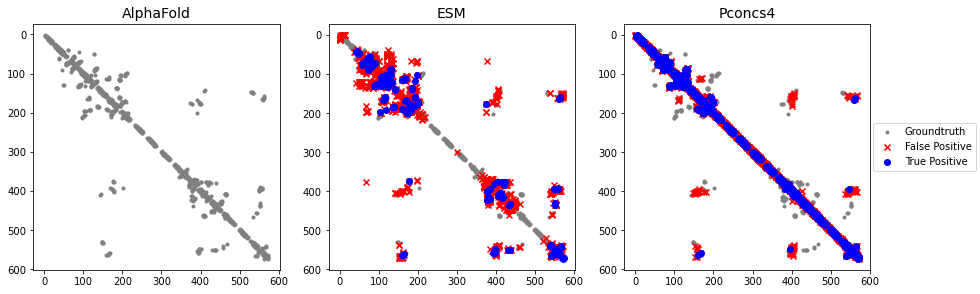

In [72]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
# title_text='Contact Map Analysis - %s'%(pro)
# fig.suptitle(title_text, fontsize=11,fontweight='bold')
#ax[0].imshow(contact_pdb,cmap="Blues")
ax[0].scatter(gt[0],gt[1],c='grey',marker=".")
ax[0].set_title('AlphaFold',fontsize=14)
ax[0].invert_yaxis()
ax[0] = ax[0].set_aspect('equal', 'box')

scatter1 = ax[1].scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
scatter2 = ax[1].scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
scatter3=ax[1].scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
ax1 = scatter1.axes
ax1.invert_yaxis()
ax2 = scatter2.axes
ax2.invert_yaxis()
ax3 = scatter3.axes
ax3.invert_yaxis()
ax[1].set_aspect('equal', 'box')
ax[1].set_title('ESM',fontsize=14)
# scatter1 = scatter1.set_aspect('equal', 'box')
# scatter2 = scatter2.set_aspect('equal', 'box')
# scatter3= scatter3.set_aspect('equal', 'box')
#ax[2] = ax[2].axes
scatter11 = ax[2].scatter(gt[0],gt[1],c='grey',marker=".")
scatter21 = ax[2].scatter(fps1[0],fps1[1],c='red', marker="x")
scatter31=ax[2].scatter(tps1[0],tps1[1],c='blue', marker="o")
ax11 = scatter11.axes
ax11.invert_yaxis()
ax21 = scatter21.axes
ax21.invert_yaxis()
ax31 = scatter31.axes
ax31.invert_yaxis()
ax[2].set_aspect('equal', 'box')
ax[2].set_title('Pconcs4',fontsize=14)
fig.legend(loc="center right")
#fig.tight_layout()
final_result_path=results_path+proteins_list[1]+".pdf"
fig.savefig(final_result_path, bbox_inches='tight',dpi=200)

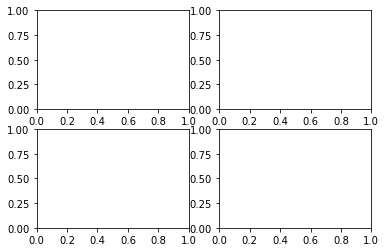

In [51]:
fig, ax = plt.subplots(2, 2)

In [25]:
def compare_cmaps1(results_path,contact_alpha,contact_esm,contact_ran,contact_pcons,protein_name):
    contact_pdb=contact_alpha
    contact_esm_flatten=contact_esm.flatten()
    contact_pdb_flatten=contact_alpha.flatten()
    contact_pcons_flatten=contact_pcons.flatten()
    contact_ran_flatten=contact_ran.flatten()
    gt=np.where(contact_pdb == 1)
    pred=np.where(contact_esm == 1)
    fps=np.where(contact_pdb-contact_esm==-1)
    tps=np.where(contact_esm+contact_pdb==2)
    fns=np.where(contact_pdb-contact_esm==1)
    pred1=np.where(contact_pcons == 1)
    fps1=np.where(contact_pdb-contact_pcons==-1)
    tps1=np.where(contact_pcons+contact_pdb==2)
    fns1=np.where(contact_pdb-contact_pcons==1)
    #compare with random cmaps
    pred2=np.where(contact_ran == 1)
    fps2=np.where(contact_pdb-contact_ran==-1)
    tps2=np.where(contact_ran+contact_pdb==2)
    fns2=np.where(contact_pdb-contact_ran==1)
    
    acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
    mcc,prec,recall=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten),precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
    
    acc1,f11=accuracy_score(contact_pdb_flatten,contact_pcons_flatten),f1_score(contact_pdb_flatten,contact_pcons_flatten)
    mcc1,prec1,recall1=matthews_corrcoef(contact_pdb_flatten,contact_pcons_flatten),precision_score(contact_pdb_flatten,contact_pcons_flatten),recall_score(contact_pdb_flatten,contact_pcons_flatten)
    
    acc2,f12=accuracy_score(contact_pdb_flatten,contact_ran_flatten),f1_score(contact_pdb_flatten,contact_ran_flatten)
    mcc2,prec2,recall2=matthews_corrcoef(contact_pdb_flatten,contact_ran_flatten),precision_score(contact_pdb_flatten,contact_ran_flatten),recall_score(contact_pdb_flatten,contact_ran_flatten)
    
    fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(18,18))

    ax[0].scatter(gt[0],gt[1],c='grey',marker=".")
    ax[0].set_title('AlphaFold',fontsize=14)
    ax[0].invert_yaxis()
    ax[0] = ax[0].set_aspect('equal', 'box')

    scatter1 = ax[1].scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
    scatter2 = ax[1].scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
    scatter3=ax[1].scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
    ax1 = scatter1.axes
    ax1.invert_yaxis()
    ax2 = scatter2.axes
    ax2.invert_yaxis()
    ax3 = scatter3.axes
    ax3.invert_yaxis()
    ax[1].set_aspect('equal', 'box')
    ax[1].set_title('ESM',fontsize=14)
    # scatter1 = scatter1.set_aspect('equal', 'box')
    # scatter2 = scatter2.set_aspect('equal', 'box')
    # scatter3= scatter3.set_aspect('equal', 'box')
    #ax[2] = ax[2].axes
    scatter11 = ax[2].scatter(gt[0],gt[1],c='grey',marker=".")
    scatter21 = ax[2].scatter(fps1[0],fps1[1],c='red', marker="x")
    scatter31=ax[2].scatter(tps1[0],tps1[1],c='blue', marker="o")
    ax11 = scatter11.axes
    ax11.invert_yaxis()
    ax21 = scatter21.axes
    ax21.invert_yaxis()
    ax31 = scatter31.axes
    ax31.invert_yaxis()
    ax[2].set_aspect('equal', 'box')
    ax[2].set_title('Pconcs4',fontsize=14)
    
    scatter12 = ax[3].scatter(gt[0],gt[1],c='grey',marker=".")
    scatter22= ax[3].scatter(fps2[0],fps2[1],c='red', marker="x")
    scatter32=ax[3].scatter(tps2[0],tps2[1],c='blue', marker="o")
    ax12 = scatter12.axes
    ax12.invert_yaxis()
    ax22 = scatter22.axes
    ax22.invert_yaxis()
    ax32 = scatter32.axes
    ax32.invert_yaxis()
    ax[3].set_aspect('equal', 'box')
    ax[3].set_title('Random',fontsize=14)
    
    fig.legend(loc="center right")
    #fig.tight_layout()
    final_result_path=results_path+protein_name+".pdf"
    fig.savefig(final_result_path, bbox_inches='tight',dpi=200)
    return mcc,f1,prec,mcc1,f11,prec1,mcc2,f12,prec2

(431, 431) (431, 431) (431, 431)
(574, 574) (574, 574) (574, 574)
(725, 725) (725, 725) (725, 725)
(970, 970) (970, 970) (970, 970)
(476, 476) (476, 476) (476, 476)
(756, 756) (756, 756) (756, 756)
(403, 403) (403, 403) (403, 403)
(740, 740) (740, 740) (740, 740)
(745, 745) (745, 745) (745, 745)
(365, 365) (365, 365) (365, 365)
(556, 556) (556, 556) (556, 556)
(454, 454) (454, 454) (454, 454)
(272, 272) (272, 272) (272, 272)
(588, 588) (588, 588) (588, 588)
(661, 661) (661, 661) (661, 661)


/disk/scratch/miniconda3/envs/mldd1/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


(802, 802) (802, 802) (802, 802)
(772, 772) (772, 772) (772, 772)
(890, 890) (890, 890) (890, 890)
(591, 591) (591, 591) (591, 591)
(543, 543) (543, 543) (543, 543)
(648, 648) (648, 648) (648, 648)


/tmp/ipykernel_392710/1852296466.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(18,18))


(796, 796) (796, 796) (796, 796)
(697, 697) (697, 697) (697, 697)
(671, 671) (671, 671) (671, 671)
(509, 509) (509, 509) (509, 509)
(537, 537) (537, 537) (537, 537)
(297, 297) (297, 297) (297, 297)
(822, 822) (822, 822) (822, 822)
(972, 972) (972, 972) (972, 972)
(543, 543) (543, 543) (543, 543)
(512, 512) (512, 512) (512, 512)
(526, 526) (526, 526) (526, 526)
(529, 529) (529, 529) (529, 529)
(976, 976) (976, 976) (976, 976)
(313, 313) (404, 404) (404, 404)
(822, 822) (822, 822) (822, 822)
(303, 303) (303, 303) (303, 303)
(536, 536) (536, 536) (536, 536)
(766, 766) (766, 766) (766, 766)
(406, 406) (406, 406) (406, 406)


/disk/scratch/miniconda3/envs/mldd1/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


(822, 822) (822, 822) (822, 822)
(672, 672) (672, 672) (672, 672)
(351, 351) (351, 351) (351, 351)
(350, 350) (350, 350) (350, 350)
(821, 821) (821, 821) (821, 821)
(802, 802) (802, 802) (802, 802)
(806, 806) (806, 806) (806, 806)
(351, 351) (351, 351) (351, 351)
(351, 351) (351, 351) (351, 351)
(525, 525) (525, 525) (525, 525)
(683, 683) (683, 683) (683, 683)
(298, 298) (298, 298) (298, 298)
(379, 379) (379, 379) (379, 379)
(753, 753) (753, 753) (753, 753)
(360, 360) (360, 360) (360, 360)
(976, 976) (976, 976) (976, 976)
(864, 864) (864, 864) (864, 864)
(646, 646) (646, 646) (646, 646)
(894, 894) (894, 894) (894, 894)
(480, 480) (480, 480) (480, 480)
(481, 481) (481, 481) (481, 481)
(590, 590) (590, 590) (590, 590)
(400, 400) (400, 400) (400, 400)
(993, 993) (993, 993) (993, 993)
(450, 450) (450, 450) (450, 450)
(467, 467) (467, 467) (467, 467)
(596, 596) (596, 596) (596, 596)
(507, 507) (507, 507) (507, 507)
(505, 505) (505, 505) (505, 505)
(619, 619) (619, 619) (619, 619)
(635, 635)

/disk/scratch/miniconda3/envs/mldd1/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


(505, 505) (505, 505) (505, 505)
(712, 712) (712, 712) (712, 712)
(740, 740) (740, 740) (740, 740)
(675, 675) (675, 675) (675, 675)
(358, 358) (358, 358) (358, 358)
(445, 445) (445, 445) (445, 445)
(841, 841) (841, 841) (841, 841)
(334, 334) (334, 334) (334, 334)
(603, 603) (603, 603) (603, 603)
(647, 647) (647, 647) (647, 647)
(367, 367) (367, 367) (367, 367)
(464, 464) (464, 464) (464, 464)
(331, 331) (331, 331) (331, 331)
(552, 552) (552, 552) (552, 552)
(987, 987) (987, 987) (987, 987)
(215, 215) (215, 215) (215, 215)
(391, 391) (391, 391) (391, 391)
(415, 415) (415, 415) (415, 415)
(326, 326) (326, 326) (326, 326)


/disk/scratch/miniconda3/envs/mldd1/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


(292, 292) (292, 292) (292, 292)
(737, 737) (737, 737) (737, 737)
(393, 393) (393, 393) (393, 393)
(954, 954) (954, 954) (954, 954)
(706, 706) (706, 706) (706, 706)
(509, 509) (509, 509) (509, 509)
(592, 592) (592, 592) (592, 592)
(676, 676) (676, 676) (676, 676)
(659, 659) (659, 659) (659, 659)
(890, 890) (890, 890) (890, 890)
(620, 620) (620, 620) (620, 620)
(820, 820) (820, 820) (820, 820)
(999, 999) (999, 999) (999, 999)
(559, 559) (559, 559) (559, 559)
(545, 545) (545, 545) (545, 545)
(524, 524) (524, 524) (524, 524)
(491, 491) (491, 491) (491, 491)
(762, 762) (762, 762) (762, 762)
(666, 666) (666, 666) (666, 666)
(558, 558) (558, 558) (558, 558)
(499, 499) (499, 499) (499, 499)
(763, 763) (763, 763) (763, 763)
(451, 451) (451, 451) (451, 451)
(671, 671) (671, 671) (671, 671)
(370, 370) (370, 370) (370, 370)
(716, 716) (716, 716) (716, 716)
(1009, 1009) (1009, 1009) (1009, 1009)
(651, 651) (651, 651) (651, 651)
(307, 307) (307, 307) (307, 307)
(436, 436) (436, 436) (436, 436)
(912

/disk/scratch/miniconda3/envs/mldd1/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


(752, 752) (752, 752) (752, 752)
(358, 358) (358, 358) (358, 358)
(588, 588) (588, 588) (588, 588)
(655, 655) (655, 655) (655, 655)
(465, 465) (465, 465) (465, 465)
(502, 502) (502, 502) (502, 502)
(367, 367) (367, 367) (367, 367)
(878, 878) (878, 878) (878, 878)
(926, 926) (926, 926) (926, 926)
(488, 488) (488, 488) (488, 488)
(646, 646) (646, 646) (646, 646)
(481, 481) (481, 481) (481, 481)
(465, 465) (465, 465) (465, 465)
(367, 367) (427, 427) (427, 427)
(313, 313) (313, 313) (313, 313)
(422, 422) (422, 422) (422, 422)
(520, 520) (520, 520) (520, 520)
(460, 460) (460, 460) (460, 460)
(800, 800) (800, 800) (800, 800)
(311, 311) (311, 311) (311, 311)
(416, 416) (416, 416) (416, 416)
(527, 527) (527, 527) (527, 527)
(816, 816) (816, 816) (816, 816)
(482, 482) (482, 482) (482, 482)
(414, 414) (414, 414) (414, 414)
(489, 489) (489, 489) (489, 489)
(569, 569) (569, 569) (569, 569)
(729, 729) (729, 729) (729, 729)
(478, 478) (478, 478) (478, 478)
(479, 479) (479, 479) (479, 479)
(629, 629)

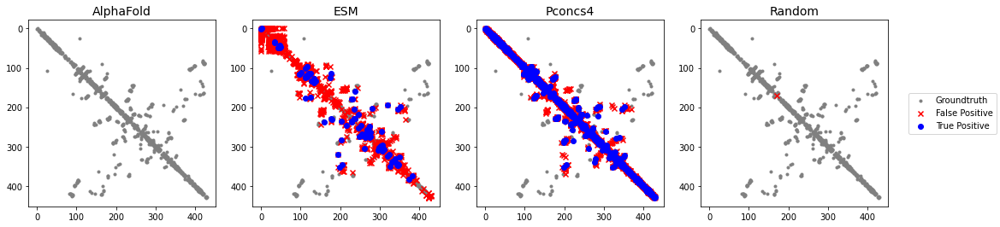

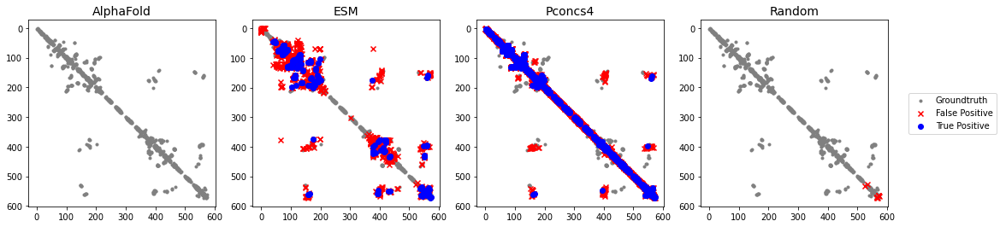

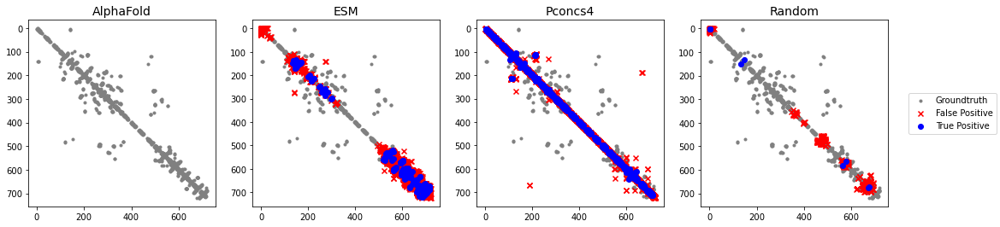

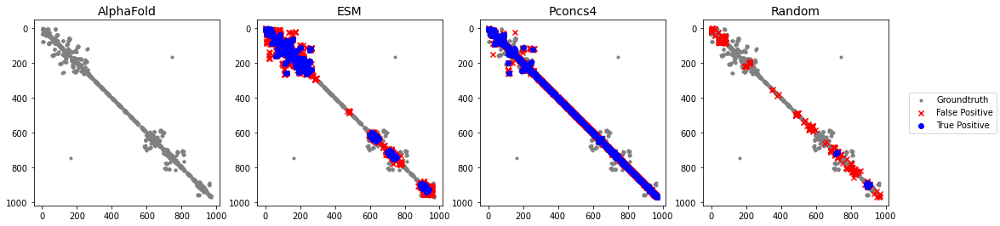

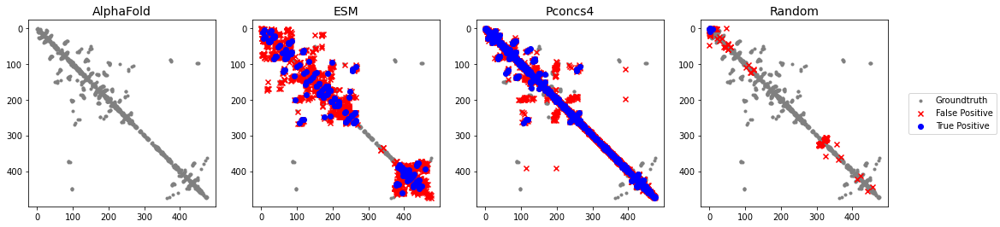

...

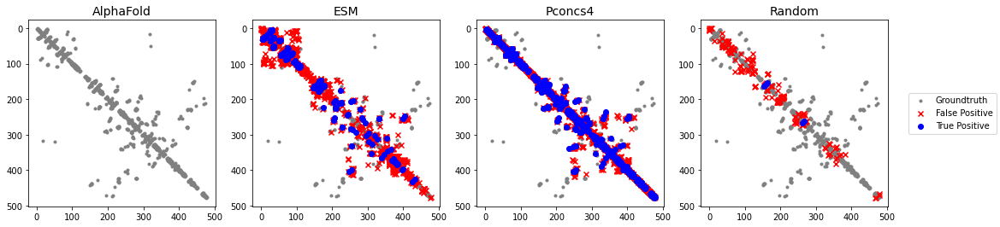

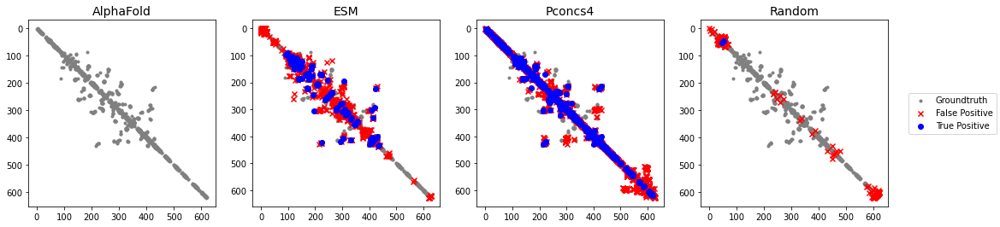

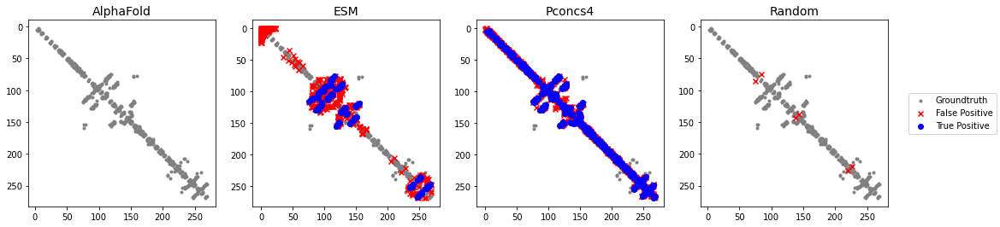

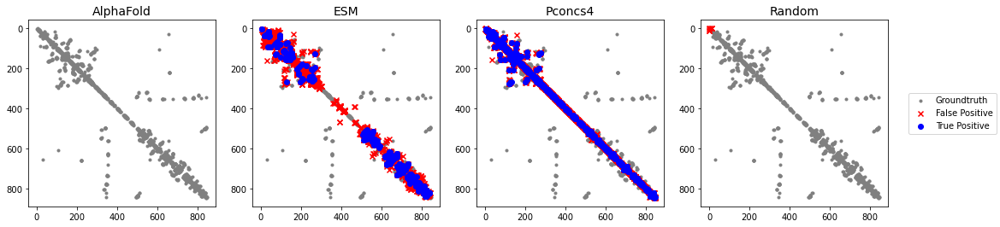

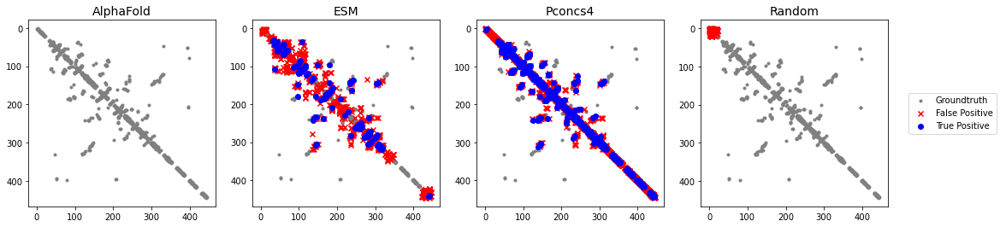

In [26]:
mcc_list=[]
mcc_list1=[]
mcc_list2=[]
f1_list=[]
f1_list1=[]
f1_list2=[]
prec_list=[]
prec_list1=[]
prec_list2=[]
for i in proteins_list:
    pro=i+".npy"
    contact_alpha=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/alpha_fold_cmaps/',pro))
    contact_esm=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/esm_cmaps_temp/',pro))
    contact_ran=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/esm_cmaps/',pro))
    contact_pcons=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/pconsc4/',pro))
    contact_pcons=np.where(contact_pcons > 0.5, 1, 0)
    print(np.shape(contact_alpha),np.shape(contact_esm),np.shape(contact_pcons))
    results_path='/disk/scratch/DGraphDTA/results1/cmaps1/'
    if contact_alpha.shape[0]==contact_esm.shape[0] and contact_alpha.shape[0]==contact_pcons.shape[0]:
        mcc,f1,prec,mcc1,f11,prec1,mcc2,f12,prec2=compare_cmaps1(results_path,contact_alpha,contact_esm,contact_ran,contact_pcons,i)
        mcc_list.append(mcc)
        mcc_list1.append(mcc1)
        mcc_list2.append(mcc2)
        f1_list.append(f1)
        f1_list1.append(f11)
        f1_list2.append(f12)
        prec_list.append(prec)
        prec_list1.append(prec1)
        prec_list2.append(prec2)
    else:
        continue

In [13]:
prot_lis1=proteins_list

In [16]:
prot_lis1

['O00141',
 'O00311',
 'O00418',
 'O00444',
 'O14757',
 'O14920',
 'O14965',
 'O15075',
 'O15111',
 'O15264',
 'O15530',
 'O43293',
 'O43741',
 'O43781',
 'O60285',
 'O75582',
 'O75676',
 'O94806',
 'O96013',
 'O96017',
 'P04049',
 'P04629',
 'P05129',
 'P05771',
 'P06239',
 'P06241',
 'P06493',
 'P07332',
 'P07333',
 'P07947',
 'P07948',
 'P08631',
 'P09769',
 'P10721',
 'P11309',
 'P11362',
 'P11802',
 'P12931',
 'P15056',
 'P15735',
 'P16591',
 'P17252',
 'P17612',
 'P19784',
 'P21802',
 'P22455',
 'P22607',
 'P22612',
 'P22694',
 'P23443',
 'P24723',
 'P24941',
 'P27361',
 'P27448',
 'P28482',
 'P29317',
 'P29376',
 'P30291',
 'P30530',
 'P31749',
 'P31751',
 'P34947',
 'P36507',
 'P36888',
 'P41240',
 'P41279',
 'P41743',
 'P42679',
 'P42685',
 'P43403',
 'P43405',
 'P45983',
 'P45984',
 'P48729',
 'P48730',
 'P49137',
 'P49336',
 'P49674',
 'P49759',
 'P49760',
 'P49840',
 'P49841',
 'P50613',
 'P50750',
 'P51451',
 'P51617',
 'P51812',
 'P51813',
 'P51817',
 'P51955',
 'P51957',

In [18]:
prot_lis1.remove('P78527')

In [21]:
for i in prot_lis1:
    print(i)

O00141
O00311
O00418
O00444
O14757
O14920
O14965
O15075
O15111
O15264
O15530
O43293
O43741
O43781
O60285
O75582
O75676
O94806
O96013
O96017
P04049
P04629
P05129
P05771
P06239
P06241
P06493
P07332
P07333
P07947
P07948
P08631
P09769
P10721
P11309
P11362
P11802
P12931
P15056
P15735
P16591
P17252
P17612
P19784
P21802
P22455
P22607
P22612
P22694
P23443
P24723
P24941
P27361
P27448
P28482
P29317
P29376
P30291
P30530
P31749
P31751
P34947
P36507
P36888
P41240
P41279
P41743
P42679
P42685
P43403
P43405
P45983
P45984
P48729
P48730
P49137
P49336
P49674
P49759
P49760
P49840
P49841
P50613
P50750
P51451
P51617
P51812
P51813
P51817
P51955
P51957
P52564
P53350
P53667
P53778
P53779
P54619
P54646
P54760
P67870
P68400
P78368
Q00534
Q00535
Q02156
Q02750
Q02779
Q04759
Q04771
Q05513
Q05655
Q06187
Q06418
Q08881
Q12851
Q12866
Q13131
Q13153
Q13177
Q13188
Q13237
Q13554
Q13555
Q13557
Q13627
Q13882
Q13976
Q14012
Q14164
Q14289
Q14680
Q15078
Q15118
Q15139
Q15418
Q15759
Q16288
Q16512
Q16513
Q16539
Q16566
Q16584
Q16620

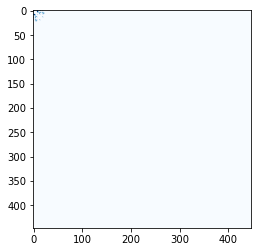

In [24]:
for i in prot_lis1:
    pro=i+".npy"
    contact_ran=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/esm_cmaps/',pro))
    plt.imshow(contact_ran,cmap="Blues")
    res='/disk/scratch/DGraphDTA/results1/cmaps_random/'+i+'.png'
    plt.savefig(res,dpi=100)

In [ ]:
for i in proteins_list:
    pro=i+".npy"
    contact_ran=np.load(os.path.join('/disk/scratch/DGraphDTA/data/kiba/esm_cmaps/',pro))
    plt.imshow(contact_ran,cmap="Blues")

In [ ]:
def getContactPercent():
    